<a href="https://colab.research.google.com/github/NishatVasker/Machine_learning_projects/blob/main/Lane_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

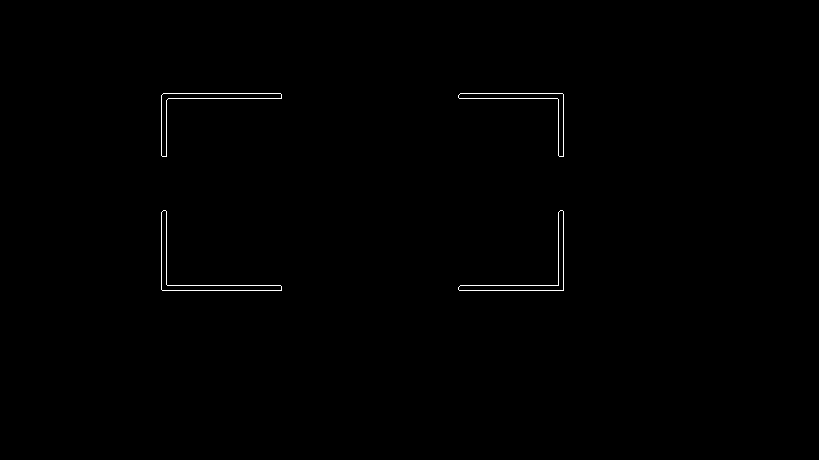

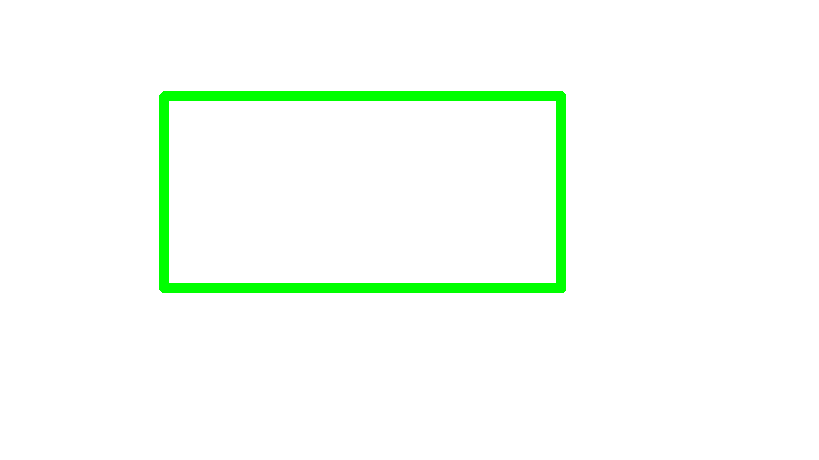

In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = cv2.imread("lines.png")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, 75, 150)

lines = cv2.HoughLinesP(edges, 1, np.pi/180, 30, maxLineGap=250)

for line in lines:
    x1, y1, x2, y2 = line[0]
    cv2.line(img, (x1, y1), (x2, y2), (0, 255, 0), 3)

#cv2.imshow("Edges", edges)
cv2_imshow(edges)
cv2_imshow(img)
cv2.imwrite("1.3_lines_with_gap.jpg", img)
cv2.waitKey(0)
cv2.destroyAllWindows()

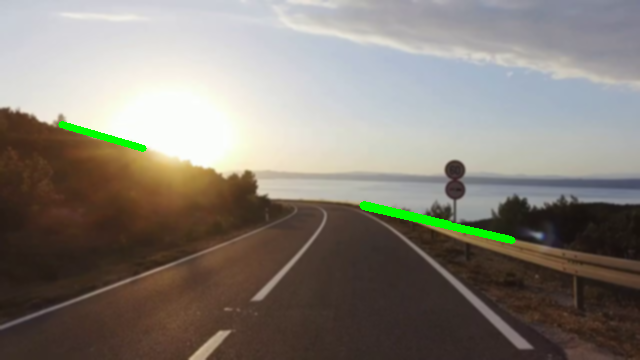

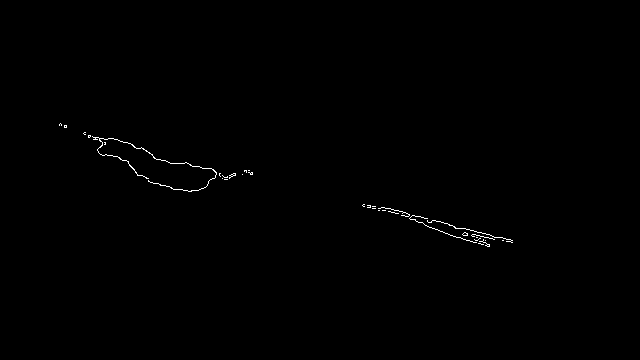

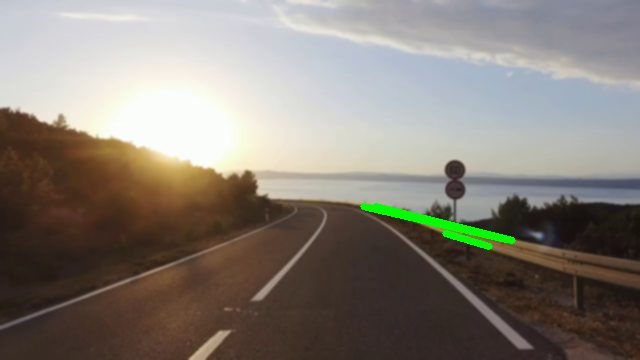

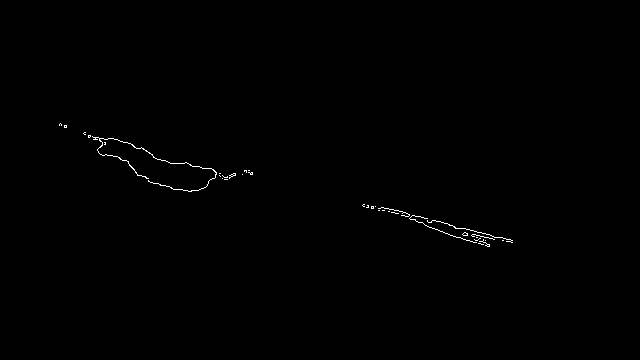

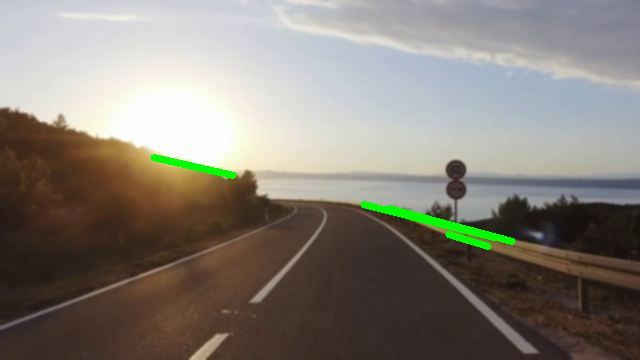

...

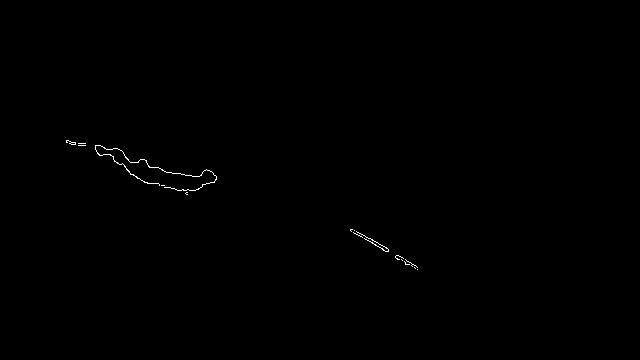

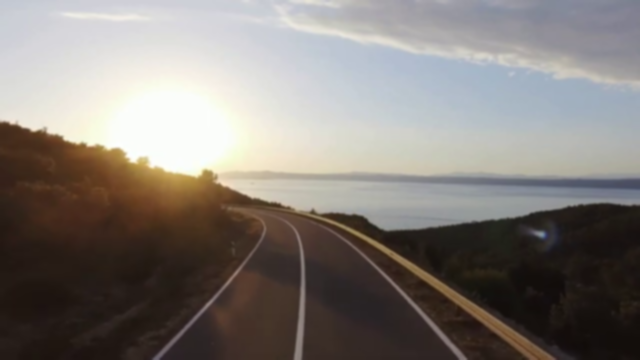

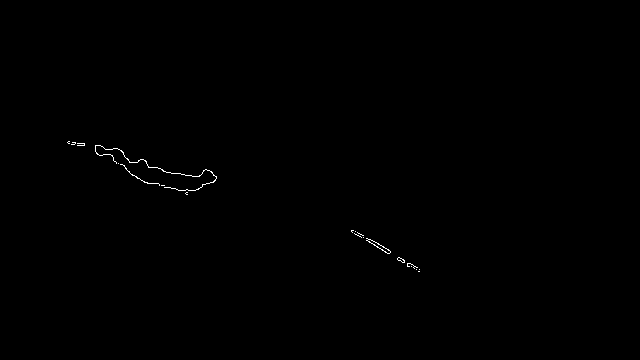

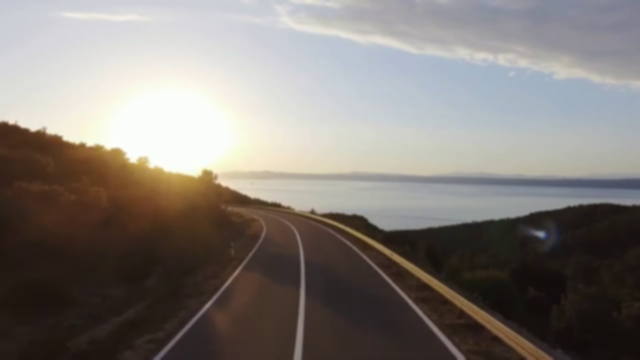

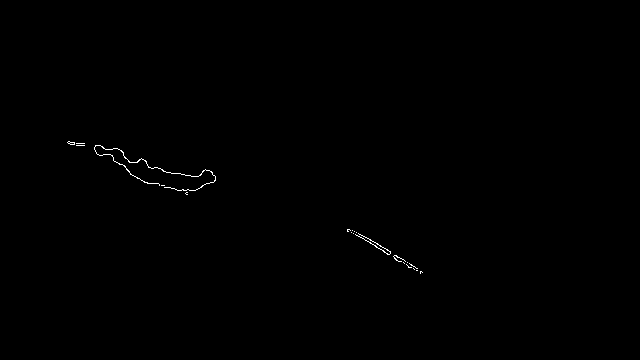

In [ ]:
import cv2
import numpy as np

video = cv2.VideoCapture("/content/videoplayback.mp4")

while True:
    ret, orig_frame = video.read()
    if not ret:
        video = cv2.VideoCapture("/content/videoplayback.mp4")
        continue

    frame = cv2.GaussianBlur(orig_frame, (5, 5), 0)
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    low_yellow = np.array([18, 94, 140])
    up_yellow = np.array([48, 255, 255])
    mask = cv2.inRange(hsv, low_yellow, up_yellow)
    edges = cv2.Canny(mask, 75, 150)

    lines = cv2.HoughLinesP(edges, 1, np.pi/180, 50, maxLineGap=50)
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), 5)

    cv2_imshow(frame)
    cv2_imshow(edges)

    key = cv2.waitKey(1)
    if key == 27:
        break
video.release()
cv2.destroyAllWindows()